In [33]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/demand/meal_info.csv
/kaggle/input/demand/fulfilment_center_info.csv
/kaggle/input/demand/master_data.csv
/kaggle/input/demand/data.csv


In [34]:
pip install pmdarima

Note: you may need to restart the kernel to use updated packages.


In [35]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import warnings 
warnings.filterwarnings('ignore')
import statsmodels.api as sm
from statsmodels.stats.stattools import durbin_watson 
from statsmodels.regression.linear_model import OLS 
from statsmodels.graphics.tsaplots import plot_acf,plot_pacf
import pandas as pd
from sklearn.metrics import r2_score

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import statistics as st
%matplotlib inline
from sklearn.preprocessing import LabelEncoder
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_log_error, mean_squared_error
import sklearn
from sklearn.model_selection import train_test_split
import pickle
from sklearn.metrics import r2_score
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error

from sklearn.preprocessing import LabelEncoder
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_log_error, mean_squared_error
import sklearn
from sklearn.model_selection import train_test_split
import pickle
from sklearn.metrics import r2_score
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error

import matplotlib.pyplot as plt
from statsmodels.tsa.statespace.varmax import VARMAX
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.vector_ar.vecm import coint_johansen
from pmdarima import auto_arima
import numpy as np
from statsmodels.tsa.stattools import adfuller
from sklearn import metrics
from timeit import default_timer as timer
import warnings
warnings.filterwarnings("ignore")

In [36]:
def evaluate(y_test, y_pred):
    return 100 * np.sqrt(mean_squared_error(y_test, y_pred))
def mape(act,pred):
    actual, pred = np.array(act), np.array(pred)
    return np.mean(np.abs((act - pred) / act)) * 100


In [37]:
master=pd.read_csv('/kaggle/input/demand/master_data.csv')

In [38]:
center=pd.read_csv('/kaggle/input/demand/fulfilment_center_info.csv')

In [39]:
meal=pd.read_csv('/kaggle/input/demand/meal_info.csv')

In [40]:
master

,id,week,center_id,meal_id,checkout_price,base_price,emailer_for_promotion,homepage_featured,num_orders,city_code,region_code,center_type,op_area,category,cuisine
0,1379560,1,55,1885,136.83,152.29,0,0,177,647,56,TYPE_C,2.0,Beverages,Thai
1,1466964,1,55,1993,136.83,135.83,0,0,270,647,56,TYPE_C,2.0,Beverages,Thai
2,1346989,1,55,2539,134.86,135.86,0,0,189,647,56,TYPE_C,2.0,Beverages,Thai
3,1338232,1,55,2139,339.50,437.53,0,0,54,647,56,TYPE_C,2.0,Beverages,Indian
4,1448490,1,55,2631,243.50,242.50,0,0,40,647,56,TYPE_C,2.0,Beverages,Indian
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
456543,1271326,145,61,1543,484.09,484.09,0,0,68,473,77,TYPE_A,4.5,Desert,Indian
456544,1062036,145,61,2304,482.09,482.09,0,0,42,473,77,TYPE_A,4.5,Desert,Indian
456545,1110849,145,61,2664,237.68,321.07,0,0,501,473,77,TYPE_A,4.5,Salad,Italian
456546,1147725,145,61,2569,243.50,313.34,0,0,729,473,77,TYPE_A,4.5,Salad,Italian


In [41]:
center

,center_id,city_code,region_code,center_type,op_area
0,11,679,56,TYPE_A,3.7
1,13,590,56,TYPE_B,6.7
2,124,590,56,TYPE_C,4.0
3,66,648,34,TYPE_A,4.1
4,94,632,34,TYPE_C,3.6
...,...,...,...,...,...
72,53,590,56,TYPE_A,3.8
73,30,604,56,TYPE_A,3.5
74,76,614,85,TYPE_A,3.0
75,68,676,34,TYPE_B,4.1


In [42]:
meal

,meal_id,category,cuisine
0,1885,Beverages,Thai
1,1993,Beverages,Thai
2,2539,Beverages,Thai
3,1248,Beverages,Indian
4,2631,Beverages,Indian
5,1311,Extras,Thai
6,1062,Beverages,Italian
7,1778,Beverages,Italian
8,1803,Extras,Thai
9,1198,Extras,Thai


Features with less correlation to be included in model

In [43]:
data=pd.read_csv('/kaggle/input/demand/data.csv')

In [44]:
data

,id,week,center_id,meal_id,checkout_price,base_price,emailer_for_promotion,homepage_featured,num_orders
0,1379560,1,55,1885,136.83,152.29,0,0,177
1,1466964,1,55,1993,136.83,135.83,0,0,270
2,1346989,1,55,2539,134.86,135.86,0,0,189
3,1338232,1,55,2139,339.50,437.53,0,0,54
4,1448490,1,55,2631,243.50,242.50,0,0,40
...,...,...,...,...,...,...,...,...,...
456543,1271326,145,61,1543,484.09,484.09,0,0,68
456544,1062036,145,61,2304,482.09,482.09,0,0,42
456545,1110849,145,61,2664,237.68,321.07,0,0,501
456546,1147725,145,61,2569,243.50,313.34,0,0,729


In [45]:
data.columns

Index(['id', 'week', 'center_id', 'meal_id', 'checkout_price', 'base_price',
       'emailer_for_promotion', 'homepage_featured', 'num_orders'],
      dtype='object')

In [52]:
promo=['emailer_for_promotion','homepage_featured']
region=['city_code','region_code','center_type']
price=['checkout_price','base_price']
cuisine=['category','cuisine']
target=['num_orders']
idd=['meal_id']
features=promo+region+cuisine
features=pd.get_dummies(master,columns=features)

In [53]:
features.checkout_price=np.log(features.checkout_price)
features.base_price=np.log(features.base_price)
features.num_orders=np.log(features.num_orders)

In [54]:
features

,id,week,center_id,meal_id,checkout_price,base_price,num_orders,op_area,emailer_for_promotion_0,emailer_for_promotion_1,...,category_Rice Bowl,category_Salad,category_Sandwich,category_Seafood,category_Soup,category_Starters,cuisine_Continental,cuisine_Indian,cuisine_Italian,cuisine_Thai
0,1379560,1,55,1885,4.918739,5.025787,5.176150,2.0,1,0,...,0,0,0,0,0,0,0,0,0,1
1,1466964,1,55,1993,4.918739,4.911404,5.598422,2.0,1,0,...,0,0,0,0,0,0,0,0,0,1
2,1346989,1,55,2539,4.904237,4.911625,5.241747,2.0,1,0,...,0,0,0,0,0,0,0,0,0,1
3,1338232,1,55,2139,5.827474,6.081145,3.988984,2.0,1,0,...,0,0,0,0,0,0,0,1,0,0
4,1448490,1,55,2631,5.495117,5.491002,3.688879,2.0,1,0,...,0,0,0,0,0,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
456543,1271326,145,61,1543,6.182271,6.182271,4.219508,4.5,1,0,...,0,0,0,0,0,0,0,1,0,0
456544,1062036,145,61,2304,6.178131,6.178131,3.737670,4.5,1,0,...,0,0,0,0,0,0,0,1,0,0
456545,1110849,145,61,2664,5.470925,5.771659,6.216606,4.5,1,0,...,0,1,0,0,0,0,0,0,1,0
456546,1147725,145,61,2569,5.495117,5.747289,6.591674,4.5,1,0,...,0,1,0,0,0,0,0,0,1,0


In [55]:
to_drop=['base_price', 'emailer_for_promotion_1', 'homepage_featured_1', 'region_code_23', 'region_code_35', 'region_code_71', 'region_code_93']

In [56]:
features=features.drop(columns=to_drop )

In [57]:
x=['meal_id', 'center_id', 'week', 'checkout_price', 'op_area',
       'emailer_for_promotion_0', 'homepage_featured_0', 'city_code_456',
       'city_code_461', 'city_code_473', 'city_code_478', 'city_code_485',
       'city_code_515', 'city_code_517', 'city_code_522', 'city_code_526',
       'city_code_541', 'city_code_553', 'city_code_556', 'city_code_561',
       'city_code_562', 'city_code_576', 'city_code_577', 'city_code_579',
       'city_code_590', 'city_code_593', 'city_code_596', 'city_code_599',
       'city_code_602', 'city_code_604', 'city_code_609', 'city_code_614',
       'city_code_615', 'city_code_620', 'city_code_628', 'city_code_632',
       'city_code_638', 'city_code_647', 'city_code_648', 'city_code_649',
       'city_code_651', 'city_code_654', 'city_code_658', 'city_code_659',
       'city_code_675', 'city_code_676', 'city_code_679', 'city_code_680',
       'city_code_683', 'city_code_685', 'city_code_693', 'city_code_695',
       'city_code_698', 'city_code_699', 'city_code_700', 'city_code_702',
       'city_code_703', 'city_code_713', 'region_code_34', 'region_code_56',
       'region_code_77', 'region_code_85', 'center_type_TYPE_A',
       'center_type_TYPE_B', 'center_type_TYPE_C', 'category_Beverages',
       'category_Biryani', 'category_Desert', 'category_Extras',
       'category_Fish', 'category_Other Snacks', 'category_Pasta',
       'category_Pizza', 'category_Rice Bowl', 'category_Salad',
       'category_Sandwich', 'category_Seafood', 'category_Soup',
       'category_Starters', 'cuisine_Continental', 'cuisine_Indian',
       'cuisine_Italian', 'cuisine_Thai']

In [58]:
X = features[x]
y=features['num_orders']
X_train, X_test = X[0:-30000], X[-30000:]
y_train,y_test=y[0:-30000], y[-30000:]

In [59]:
X

,meal_id,center_id,week,checkout_price,op_area,emailer_for_promotion_0,homepage_featured_0,city_code_456,city_code_461,city_code_473,...,category_Rice Bowl,category_Salad,category_Sandwich,category_Seafood,category_Soup,category_Starters,cuisine_Continental,cuisine_Indian,cuisine_Italian,cuisine_Thai
0,1885,55,1,4.918739,2.0,1,1,0,0,0,...,0,0,0,0,0,0,0,0,0,1
1,1993,55,1,4.918739,2.0,1,1,0,0,0,...,0,0,0,0,0,0,0,0,0,1
2,2539,55,1,4.904237,2.0,1,1,0,0,0,...,0,0,0,0,0,0,0,0,0,1
3,2139,55,1,5.827474,2.0,1,1,0,0,0,...,0,0,0,0,0,0,0,1,0,0
4,2631,55,1,5.495117,2.0,1,1,0,0,0,...,0,0,0,0,0,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
456543,1543,61,145,6.182271,4.5,1,1,0,0,1,...,0,0,0,0,0,0,0,1,0,0
456544,2304,61,145,6.178131,4.5,1,1,0,0,1,...,0,0,0,0,0,0,0,1,0,0
456545,2664,61,145,5.470925,4.5,1,1,0,0,1,...,0,1,0,0,0,0,0,0,1,0
456546,2569,61,145,5.495117,4.5,1,1,0,0,1,...,0,1,0,0,0,0,0,0,1,0


In [61]:
from xgboost import XGBRegressor

In [62]:
xgb = XGBRegressor(objective='reg:squarederror', random_state=41,missing=0.0, n_jobs=8, 
                   max_depth=9, n_estimators=300, min_child_weight=45)

In [63]:
xgb.fit(X_train, y_train)

XGBRegressor(base_score=0.5, booster='gbtree', callbacks=None,
             colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,
             early_stopping_rounds=None, enable_categorical=False,
             eval_metric=None, gamma=0, gpu_id=-1, grow_policy='depthwise',
             importance_type=None, interaction_constraints='',
             learning_rate=0.300000012, max_bin=256, max_cat_to_onehot=4,
             max_delta_step=0, max_depth=9, max_leaves=0, min_child_weight=45,
             missing=0.0, monotone_constraints='()', n_estimators=300, n_jobs=8,
             num_parallel_tree=1, predictor='auto', random_state=41,
             reg_alpha=0, reg_lambda=1, ...)

In [64]:
y_pred = xgb.predict(X_test)
pred=pd.DataFrame([])
pred['original']=y_test
pred['predict']=y_pred
print('The R Squared is',round(r2_score(y_test,y_pred)*100,2))
print('The MAPE Squared is',round(mape(y_test,y_pred),2))

The R Squared is 80.18
The MAPE Squared is 9.45


In [65]:
pred

,original,predict
426548,3.737670,3.533566
426549,3.295837,3.862622
426550,6.792344,6.228333
426551,6.920672,6.792227
426552,6.821107,6.686810
...,...,...
456543,4.219508,3.681086
456544,3.737670,3.264397
456545,6.216606,5.527726
456546,6.591674,5.810040


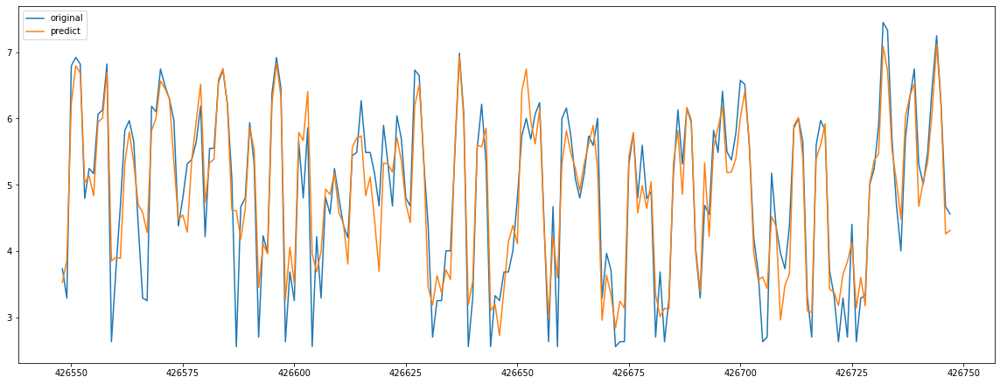

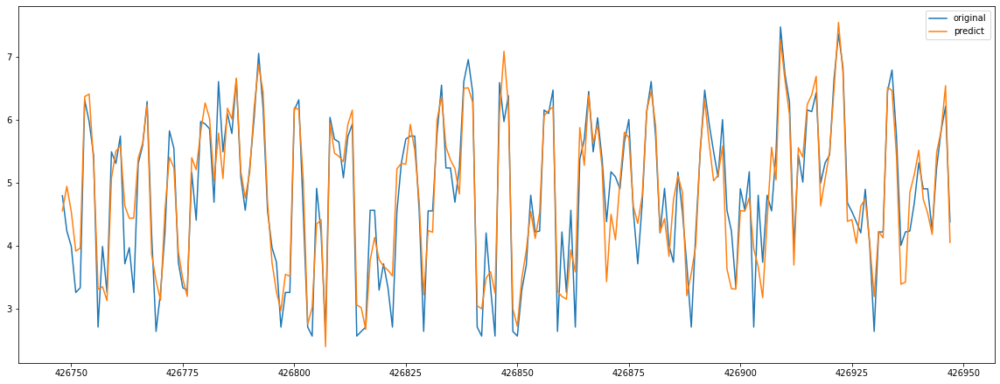

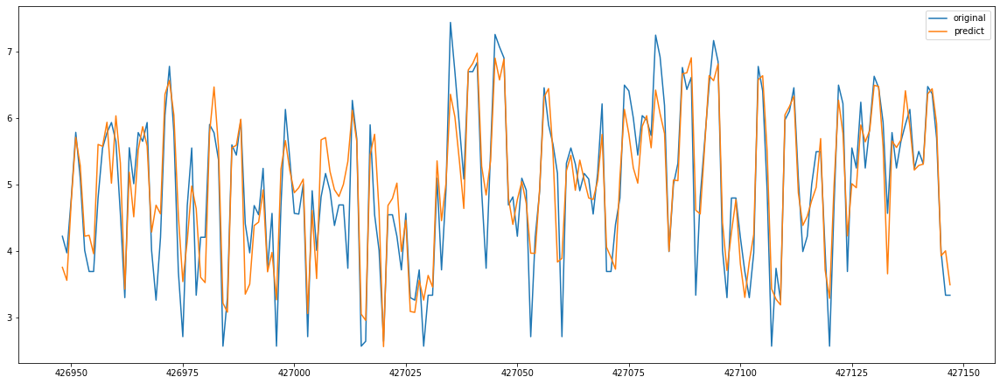

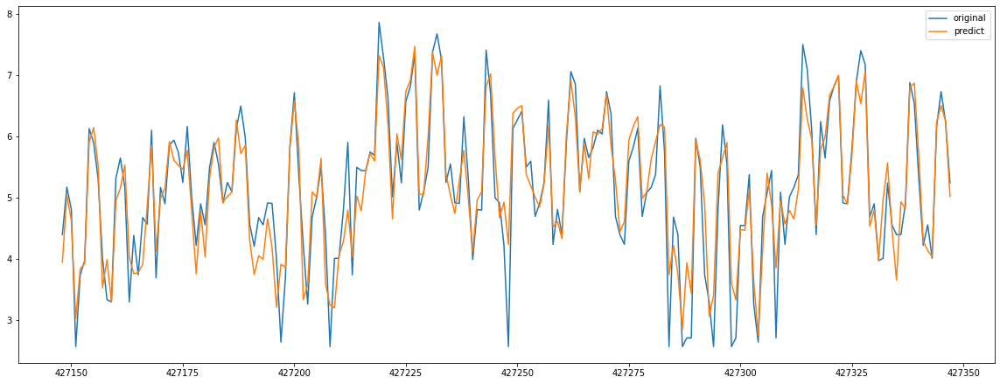

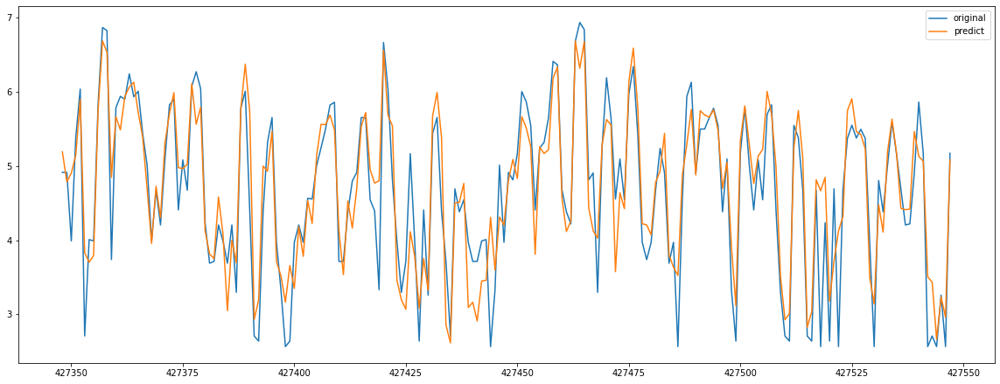

...

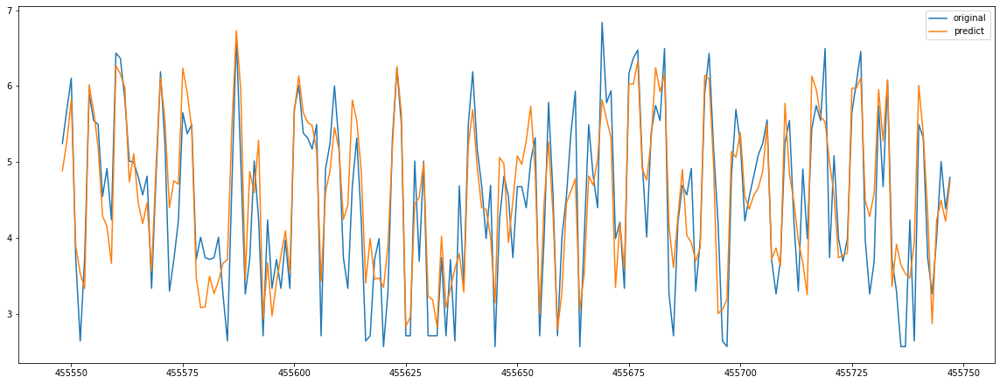

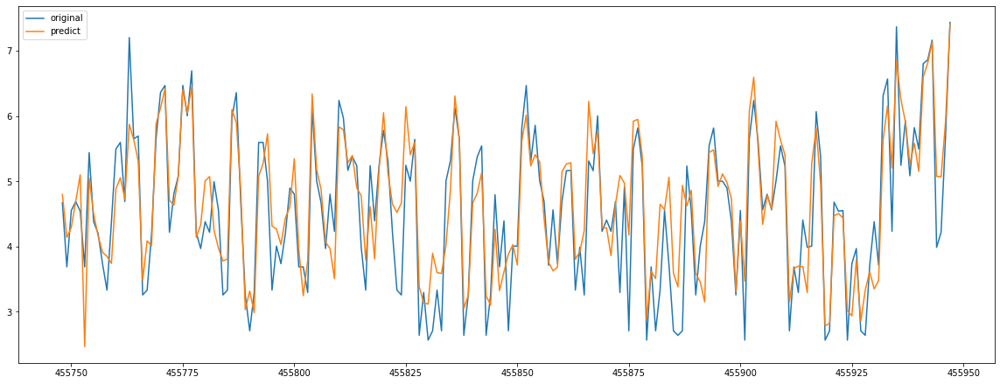

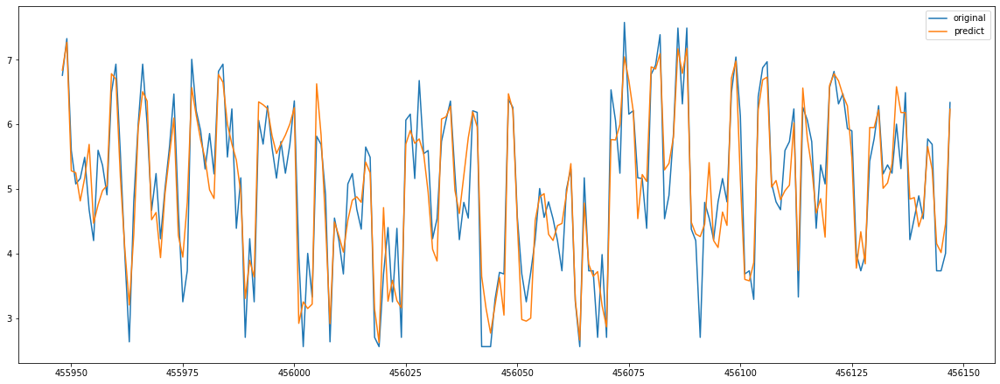

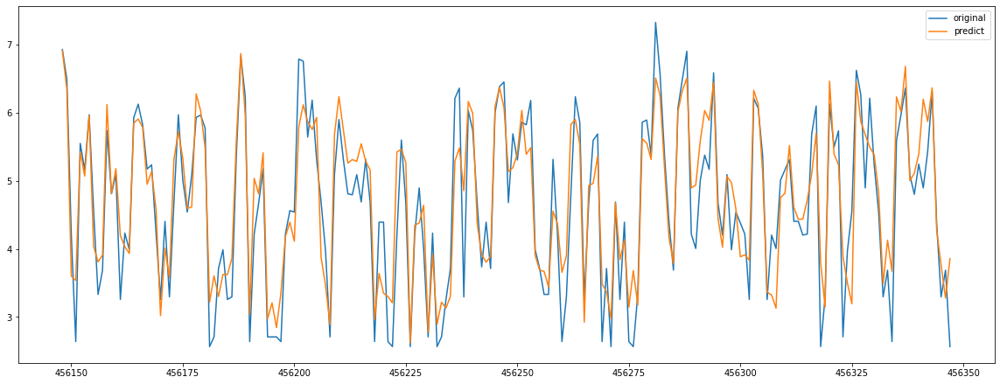

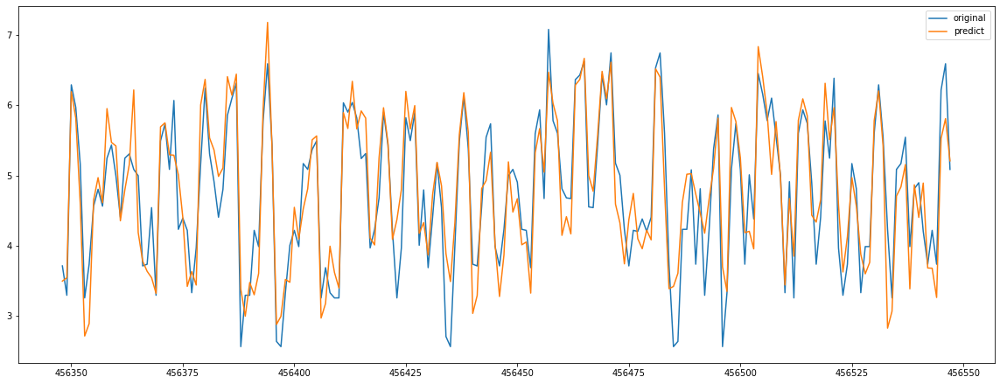

In [66]:
for i in range (int(len(pred)/200)):
    pred[(i*200):((i+1)*200)].plot(figsize=(20,7.5))